###  <span style="color:red">**This Notebook can be run from Google Colab:**</span>

https://colab.research.google.com

# **<span style="color:red">Background:</span>**

#### For each test image, we created heatmaps of predicted probabilities for each and every class. To do that, we first generated overlapping patches then we used our final model to predict the class probabilities for each patch.<br>

#### Our model accepts patch_size input = (128x128) pixels and we used stride = (8x8) pixels to generate overlapping patches. Each 8x8 pixels region in our test images was then contained in 16 (128/8) different overlapping patches so, after getting the predicted class probabilities for each patch, we used simple voting to create a heatmap of class probabilities for each inidividual 8x8 pixels region in the test images.<br>

#### The heatmaps for all test images were stored in a single array of size (N x test-image_height/stride[0] x test-image_width/stride[1] x n_classes), where N is the number of test images and n_classes = 9. We also created a list of file paths where we stored the file path for each test image, in the same order as they are contained in the array of heatmaps.<br> 

#### **Here we will now use the probability heatmaps, to find the predicted probabilities for any region of any size within the test images and show different options on which we can use the class probabilities heatmaps, to visualize the results.**<br>

In [0]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import os
import zipfile
import shutil
import json
import pickle
import cv2 as cv

# Import PyDrive and associated libraries (to connect with GoogleDrive):
from pydrive.auth import GoogleAuth
from pydrive.drive import GoogleDrive
from google.colab import auth
from oauth2client.client import GoogleCredentials

### **Download Test Images:**

In [2]:
# Authenticate and create the PyDrive client.
auth.authenticate_user()
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive = GoogleDrive(gauth)

file_id = '1HUGz21xM0BV7CFInFTK6F0D5NOk_58U1'

downloaded = drive.CreateFile({'id': file_id})
downloaded.GetContentFile(downloaded['title'])
print('"{}" sucessfully downloaded'.format(downloaded['title']))

if 'test_images' in os.listdir():
    shutil.rmtree('./test_images')
with zipfile.ZipFile(downloaded['title'],"r") as zipObj:
    zipObj.extractall('test_images')
os.remove(downloaded['title'])
print('Root dir content: {}'.format(os.listdir()))

"mixed_colony_images.zip" sucessfully downloaded
Root dir content: ['.config', 'test_images', 'adc.json', 'sample_data']


### **Let's explore the content of test_images folder:**

In [3]:
print('content of test_images folder:')
for i, folder in enumerate(os.listdir('test_images')):
    print("\n there is a folder named '{}'.\n First 5 files in '{}'':".format(folder, folder))
    for file in os.listdir('./test_images/' + folder)[:5]:
        print('   ', file)

content of test_images folder:

 there is a folder named 'mixed_colony_images_nogt'.
 First 5 files in 'mixed_colony_images_nogt'':
    Mixed-colony_22_053.jpg
    Mixed-colony_09_044.jpg
    Mixed-colony_13_047.jpg
    Mixed-colony_18_064.jpg
    Mixed-colony_14_042.jpg

 there is a folder named 'mixed_colony_images_gt'.
 First 5 files in 'mixed_colony_images_gt'':
    Mixed-colony_05_016.jpg
    Mixed-colony_29_023.jpg
    Mixed-colony_24_032.jpg
    Mixed-colony_28_034.jpg
    Mixed-colony_20_022.jpg


### **Let's download pickle files containing the heatmaps for all test images and the list where we stored the file path for each test image, in the same order as they are contained in the array of heatmaps:**

In [4]:
# Authenticate and create the PyDrive client:
auth.authenticate_user()
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive = GoogleDrive(gauth)

heatmaps_id = '1qf9IVb3DYI0kCGlYrNBUMelhr0n0hxKY' # heatmaps for stride (8,8)
img_paths_id = '1-T4H7u6q3uNEPEm0DZrdaCijB8_Q_v-V' # img_paths for stride (8,8)

files_ids_dict = {'heatmaps': heatmaps_id,
                  'img_paths': img_paths_id}

file_names_dict = {}
for file_name, file_id in files_ids_dict.items():
    downloaded = drive.CreateFile({'id': file_id})
    downloaded.GetContentFile(downloaded['title'])
    print('Downloaded content: "{}"'.format(downloaded['title']))
    file_names_dict[file_name] = downloaded['title']

print('\nfile_names_dict:', str(json.dumps(file_names_dict, indent=2, default=str)))

print('\nRoot dir content: {}'.format(os.listdir()))

Downloaded content: "heatmaps_8_8.pkl"
Downloaded content: "img_paths_8_8.pkl"

file_names_dict: {
  "heatmaps": "heatmaps_8_8.pkl",
  "img_paths": "img_paths_8_8.pkl"
}

Root dir content: ['.config', 'test_images', 'adc.json', 'img_paths_8_8.pkl', 'heatmaps_8_8.pkl', 'sample_data']


### **Let's load the downloaded 'heatmaps' file, into an array called 'heatmaps' and the downloaded image-paths file, into a list called 'img_paths':**

In [5]:
heatmaps = np.load(file_names_dict['heatmaps'], allow_pickle=True)
os.remove(file_names_dict['heatmaps'])
img_paths = pickle.load(open(file_names_dict['img_paths'], 'rb'))
os.remove(file_names_dict['img_paths'])

print('\nRoot dir content (after removing downloaded files): {}'.format(os.listdir()))


Root dir content (after removing downloaded files): ['.config', 'test_images', 'adc.json', 'sample_data']


### **Let's visualize the probability heatmaps for each class, for one of the test images:**

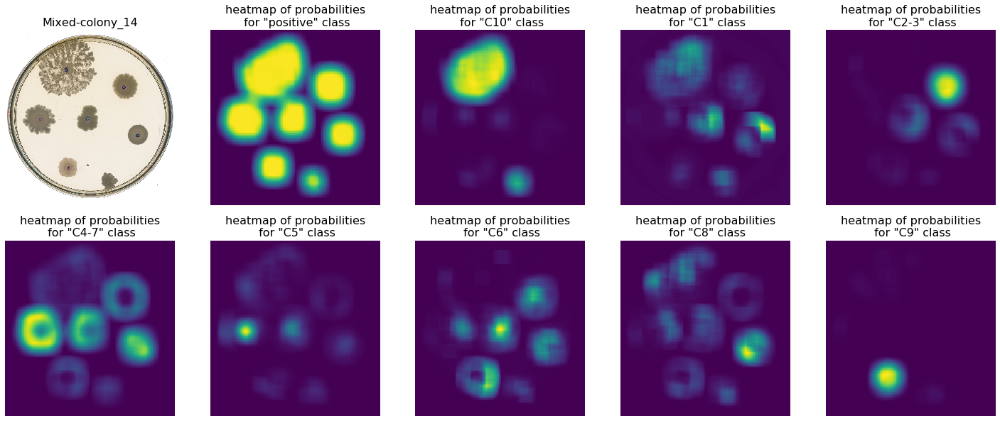

In [466]:
class_dict = {0: "C10",
              1 :"C1",
              2: "C2-3",
              3: "C4-7",
              4: "C5",
              5: "C6",
              6: "C8",
              7: "C9",
              8: "neg"}

heatmaps_pos = np.copy(heatmaps)
heatmaps_pos[:,:,:,8] = -heatmaps_pos[:,:,:,8] + 255 # prob for 'neg' -> prob for 'pos'
class_dict_pos = class_dict.copy()
class_dict_pos[8] = "positive"
root_path = 'test_images/mixed_colony_images_nogt/'

i = 12  # this image contains several well-separated species
heatmap = heatmaps_pos[i]
img = cv.imread(img_paths[i])
img_name = img_paths[i][len(root_path):len(root_path)+15]

plt.figure(figsize=(25,10))
plt.rcParams["axes.grid"] = False
plt.subplot(2,5,1),plt.imshow(np.rot90(img)[:, :, [2, 1, 0]]) # From BGR to RGB
plt.axis('off')
plt.title(img_name, fontsize=16)

desired_order = [8,0,1,2,3,4,5,6,7]

for i, chn in enumerate(desired_order):
    class_heatmap = heatmap[:,:,chn].astype('uint8') # each channel store each class probabilities
    plt.subplot(2,5,i+2),plt.imshow(np.rot90(class_heatmap))
    plt.axis('off')
    plt.title('heatmap of probabilities\n for "{}" class'.format(class_dict_pos[chn]), fontsize=16)

plt.show()

#### <br>Above we can visualize one test image followed by the probability heatmaps for each of the 9 classes in our model.<br>

#### **Using those probability heatmaps, we can as example, choose any region of any size within the image and get the predicted probabilities for each class:**





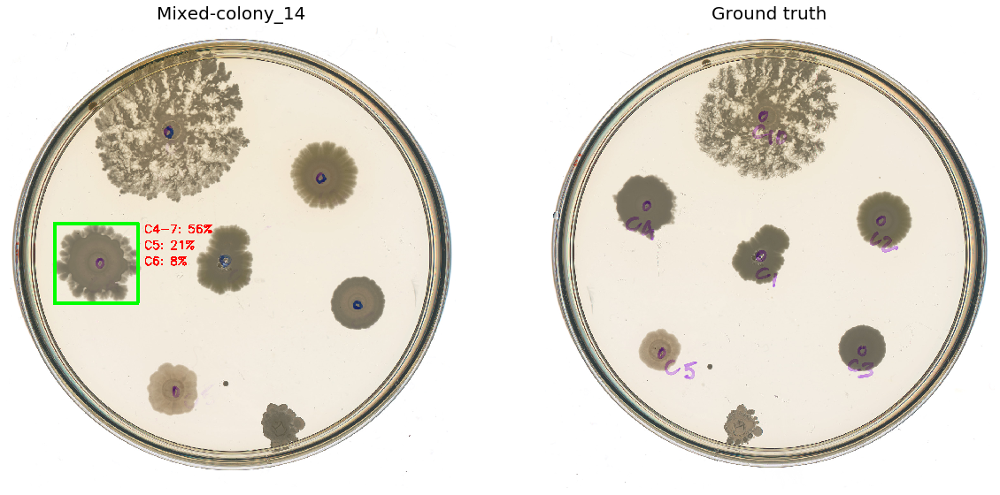

In [229]:
"""
As example, let's select a region of any size by changing the x1,y1,x2,y2 parameters
below and get the predicted probabilities for such region: 

0,0--------------------------------
|                                 |
|                                 |
|     x1,y1 --------              |
|       |          |              |
|       |          |              |
|       |          |              |
|       --------x2,y2             |
|                                 |
|                                 |
|                                 |
-----------------------------width,height
"""

"""Enter x1, y1, x2, y2 below:"""
x1,y1,x2,y2 = 150,620,410,870

i = 12  # this image contains several well-separated species
stride = (8,8)
img = cv.imread(img_paths[i])
img_name = img_paths[i][len(root_path):len(root_path)+15]
gt_root_path = 'test_images/mixed_colony_images_gt/'
for gt_img_name in os.listdir(gt_root_path):
    if img_name in gt_img_name: gt_img_path = gt_root_path + gt_img_name 
gt_img = cv.imread(gt_img_path) # ground truth image

img2 = np.rot90(img).copy() # rotate, as we need to rotate gt to read better
heatmap = np.rot90(heatmaps[i]) # we need to rotate the heatmaps as well
cv.rectangle(img2,(x1,y1),(x2,y2),(0,255,0),10) # draw the rectangle

x,y,w,z = int(x1/stride[1]),int(y1/stride[0]),int(x2/stride[1]),int(y2/stride[0])
probs = np.sum(heatmap[y:z,x:w,:],axis=tuple(range(heatmap.ndim-1)))
probs *= 100/np.sum(probs) # normalize to 0-100%
sort_probs = np.argsort(-probs) # "-" to order higher to smaller

for k in range(3):
    y_pred, prob = sort_probs[k], int(round(probs[sort_probs[k]]))
    cv.putText(img2,'{}: {}%'.format(class_dict[y_pred],prob),
		    (x2+20,y1+30+k*50), cv.FONT_HERSHEY_SIMPLEX, 1.2, (0, 0, 255), 3)

plt.figure(figsize=(20,10))
plt.rcParams["axes.grid"] = False
plt.subplot(1,2,1),plt.imshow(img2[:, :, [2, 1, 0]]) # From BGR to RGB
plt.axis('off')
plt.title(img_name, fontsize=20)

plt.subplot(1,2,2),plt.imshow(np.rot90(gt_img)[:, :, [2, 1, 0]]) # From BGR to RGB
plt.axis('off')
plt.title('Ground truth', fontsize=20)

plt.show()

#### <br>**Let's now manually choose several other regions and see the top 3 predicted classes for each one of them:**

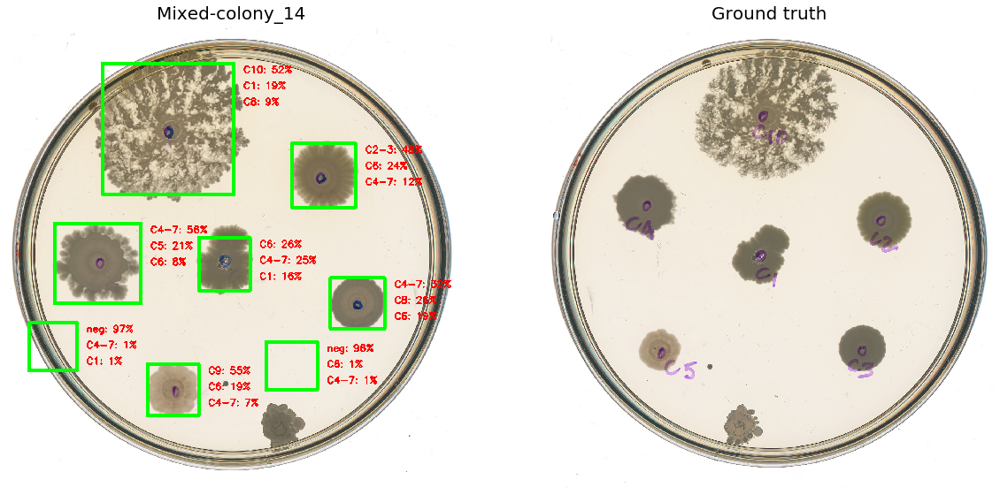

In [231]:
stride = (8,8)
i = 12  # this image contains several well-separated species
img = cv.imread(img_paths[i])
img_name = img_paths[i][len(root_path):len(root_path)+15]
gt_root_path = 'test_images/mixed_colony_images_gt/'
for gt_img_name in os.listdir(gt_root_path):
    if img_name in gt_img_name: gt_img_path = gt_root_path + gt_img_name 
gt_img = cv.imread(gt_img_path) # ground truth image

img2 = np.rot90(img).copy() # rotate, as we need to rotate gt to read better
heatmap = np.rot90(heatmaps[i]) # we need to rotate the heatmaps as well

area1 = 150,620,420,870
area2 = 300,120,710,530
area3 = 600,665,760,830
area4 = 890,370,1090,570
area5 = 1010,790,1180,950
area6 = 440,1060,600,1220
area7 = 810,990,970,1140
area8 = 70,930,220,1080

areas = [area1,area2,area3,area4,area5,area6,area7,area8]

for area in areas:
    x1,y1,x2,y2 = area
    cv.rectangle(img2,(x1,y1),(x2,y2),(0,255,0),10) # draw the rectangle
    x,y,w,z = int(x1/stride[1]),int(y1/stride[0]),int(x2/stride[1]),int(y2/stride[0])
    probs = np.sum(heatmap[y:z,x:w,:],axis=tuple(range(heatmap.ndim-1)))
    probs *= 100/np.sum(probs) # normalize to 0-100%
    sort_probs = np.argsort(-probs) # "-" to order higher to smaller
    for k in range(3):
        y_pred, prob = sort_probs[k], int(round(probs[sort_probs[k]]))
        cv.putText(img2,'{}: {}%'.format(class_dict[y_pred],prob),
            (x2+30,y1+30+k*50), cv.FONT_HERSHEY_SIMPLEX, 1.0, (0, 0, 255), 3)

plt.figure(figsize=(20,10))
plt.rcParams["axes.grid"] = False
plt.subplot(1,2,1),plt.imshow(img2[:, :, [2, 1, 0]]) # From BGR to RGB
plt.axis('off')
plt.title(img_name, fontsize=20)

plt.subplot(1,2,2),plt.imshow(np.rot90(gt_img)[:, :, [2, 1, 0]]) # From BGR to RGB
plt.axis('off')
plt.title('Ground truth', fontsize=20)

plt.show()

#### <br>**Now, instead of manually choosing the image regions by ourselves, for those test images where we have well separated colonies, the model should be able to identify positive regions corresponding to a single colony and we can then use such info to annotate the predicted probabilities for each of the indentified single colonies.**

#### **For the above, let's first visualize the heatmaps for the 'negative'/'positive' class prediction for "all" test images so we can select the images where colonies are well separated:**



"positive vs negative" heatmap for "Mixed-colony_21_052.jpg" (index 0):


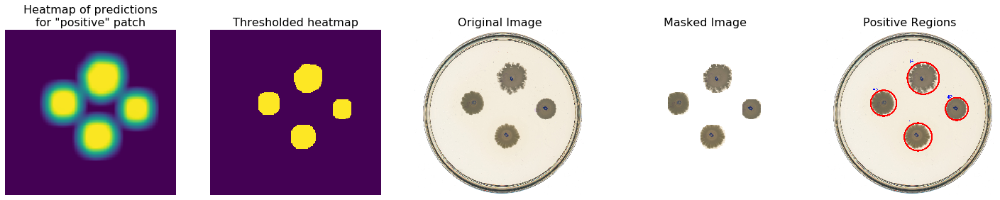



"positive vs negative" heatmap for "Mixed-colony_25_056.jpg" (index 1):


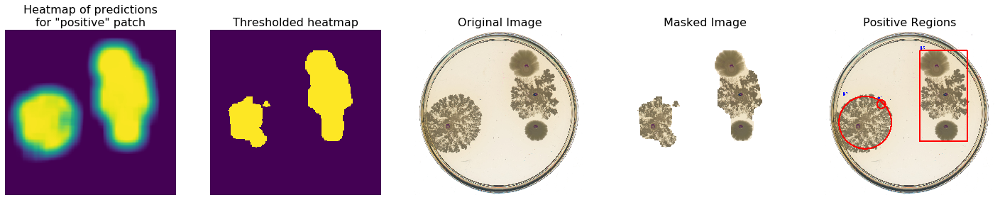



"positive vs negative" heatmap for "Mixed-colony_16_037.jpg" (index 2):


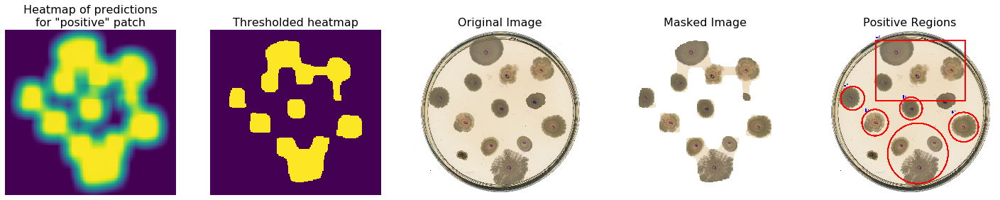



"positive vs negative" heatmap for "Mixed-colony_24_058.jpg" (index 3):


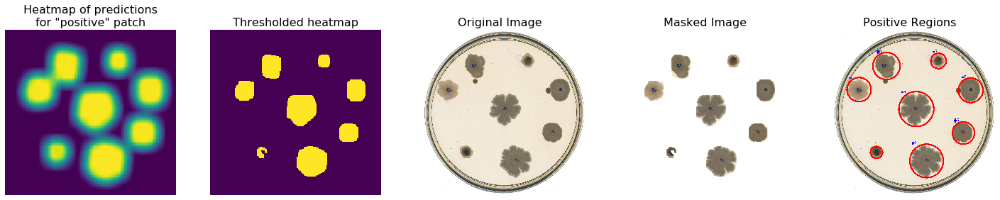



"positive vs negative" heatmap for "Mixed-colony_07_036.jpg" (index 4):


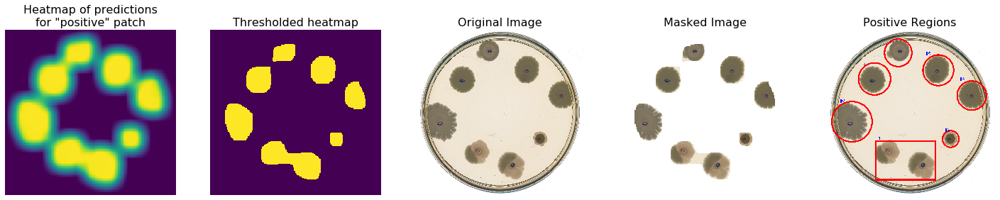



"positive vs negative" heatmap for "Mixed-colony_11_062.jpg" (index 5):


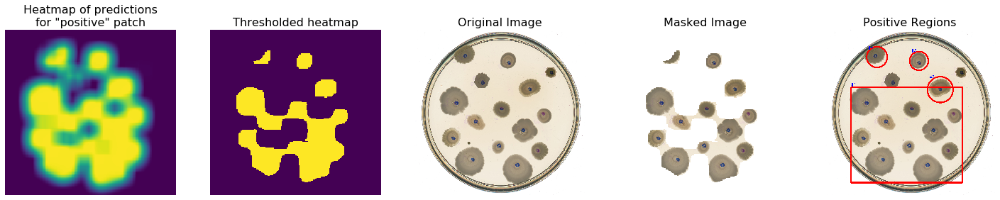



"positive vs negative" heatmap for "Mixed-colony_10_045.jpg" (index 6):


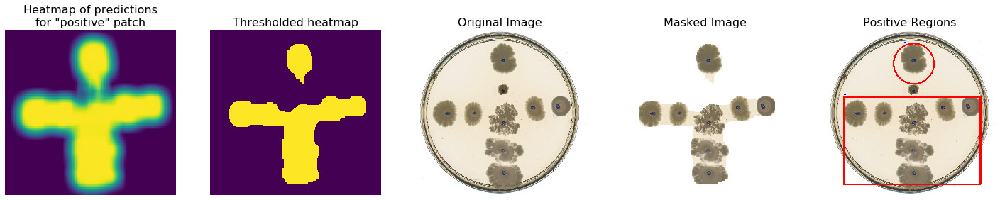



"positive vs negative" heatmap for "Mixed-colony_05_055.jpg" (index 7):


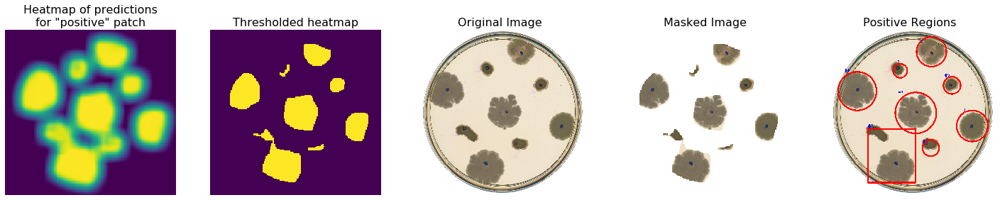



"positive vs negative" heatmap for "Mixed-colony_23_063.jpg" (index 8):


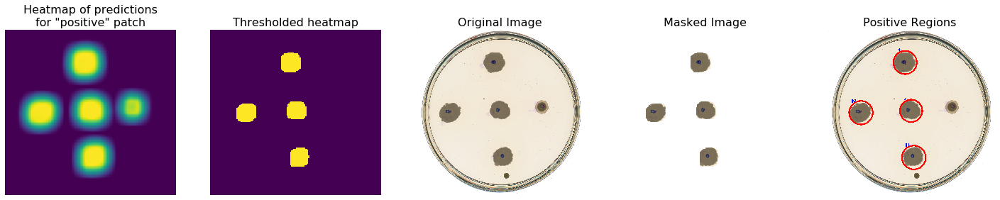



"positive vs negative" heatmap for "Mixed-colony_04_040.jpg" (index 9):


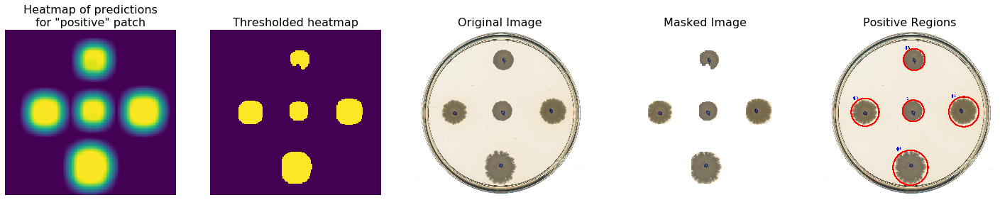



"positive vs negative" heatmap for "Mixed-colony_08_051.jpg" (index 10):


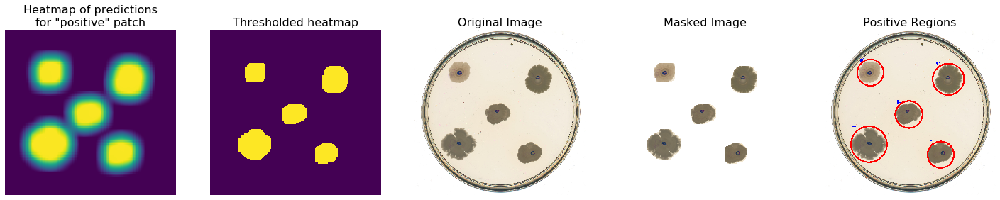



"positive vs negative" heatmap for "Mixed-colony_18_064.jpg" (index 11):


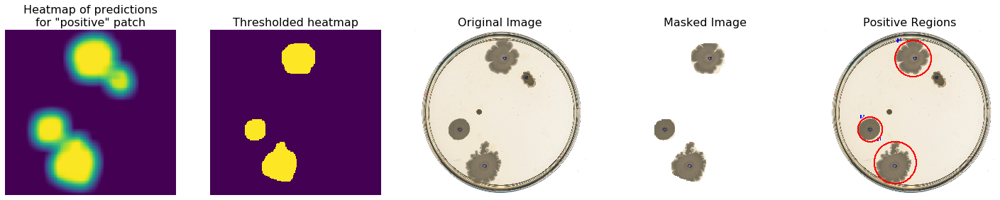



"positive vs negative" heatmap for "Mixed-colony_14_042.jpg" (index 12):


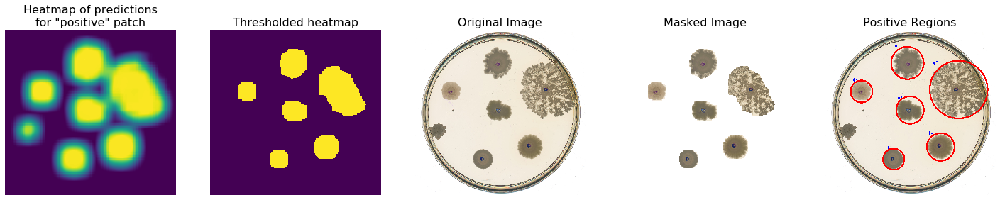



"positive vs negative" heatmap for "Mixed-colony_22_053.jpg" (index 13):


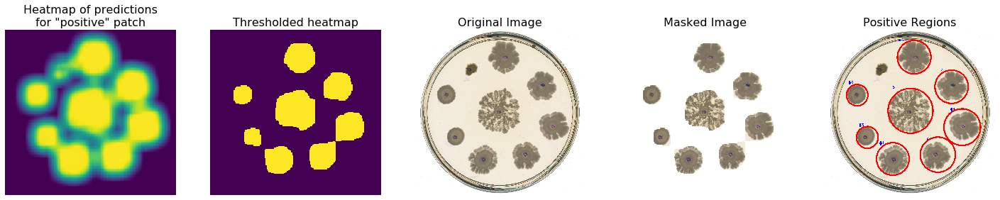



"positive vs negative" heatmap for "Mixed-colony_19_061.jpg" (index 14):


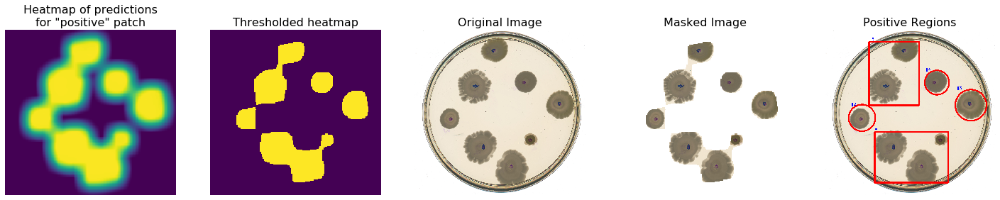



"positive vs negative" heatmap for "Mixed-colony_15_039.jpg" (index 15):


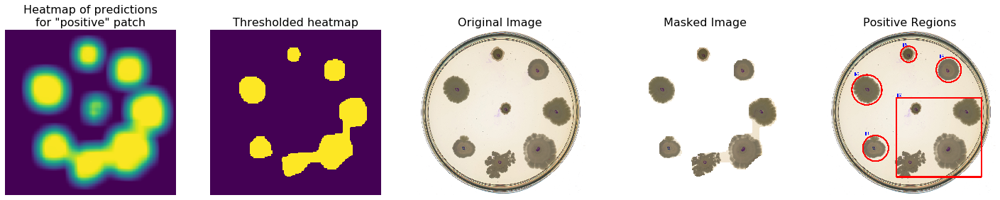



"positive vs negative" heatmap for "Mixed-colony_28_057.jpg" (index 16):


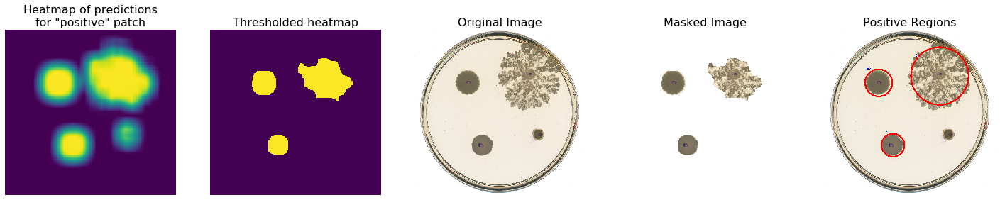



"positive vs negative" heatmap for "Mixed-colony_20_049.jpg" (index 17):


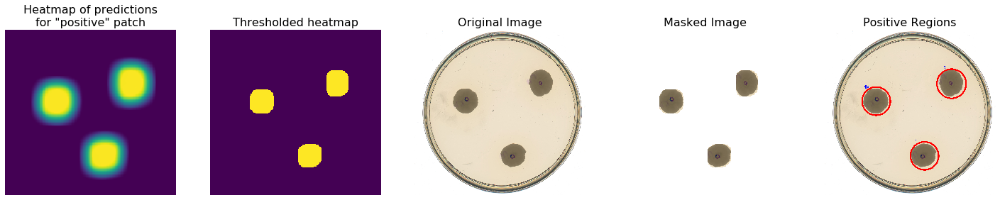



"positive vs negative" heatmap for "Mixed-colony_01_043.jpg" (index 18):


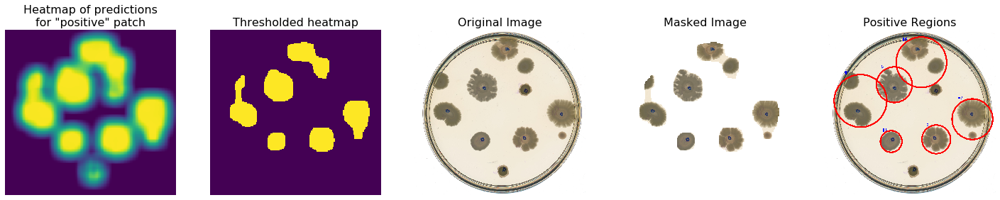



"positive vs negative" heatmap for "Mixed-colony_29_048.jpg" (index 19):


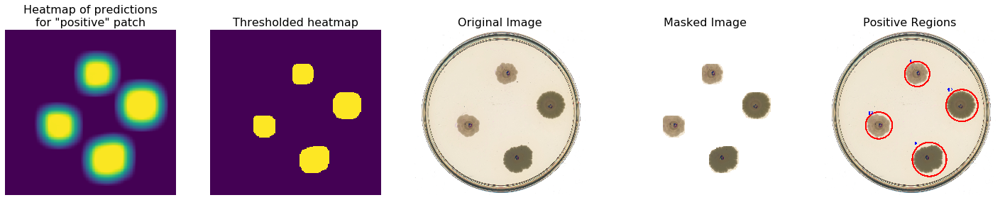



"positive vs negative" heatmap for "Mixed-colony_09_044.jpg" (index 20):


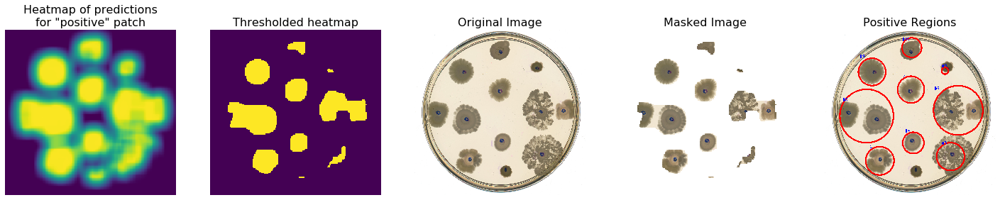



"positive vs negative" heatmap for "Mixed-colony_02_046.jpg" (index 21):


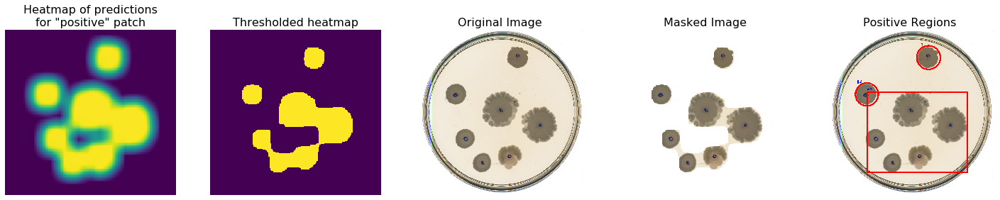



"positive vs negative" heatmap for "Mixed-colony_17_065.jpg" (index 22):


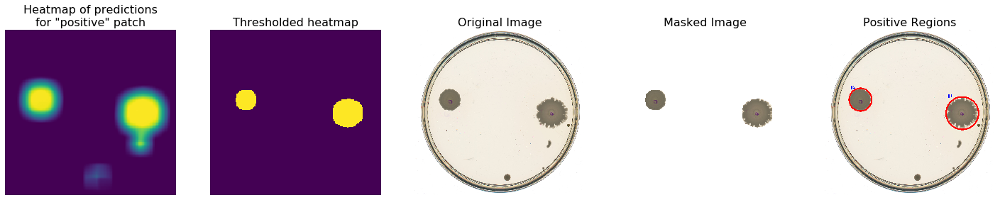



"positive vs negative" heatmap for "Mixed-colony_27_050.jpg" (index 23):


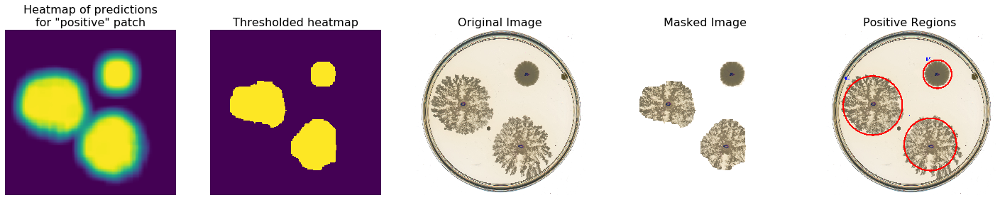



"positive vs negative" heatmap for "Mixed-colony_12_041.jpg" (index 24):


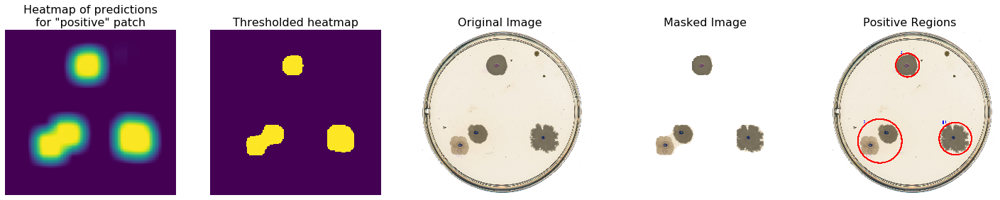



"positive vs negative" heatmap for "Mixed-colony_30_060.jpg" (index 25):


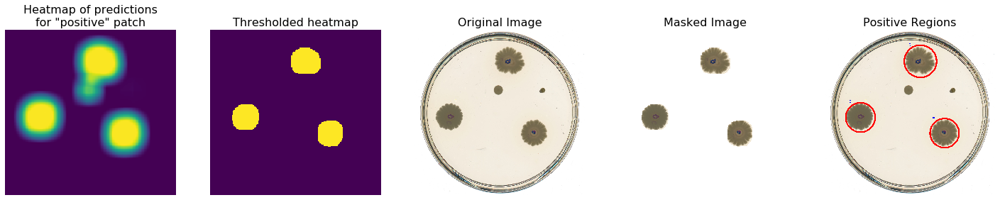



"positive vs negative" heatmap for "Mixed-colony_13_047.jpg" (index 26):


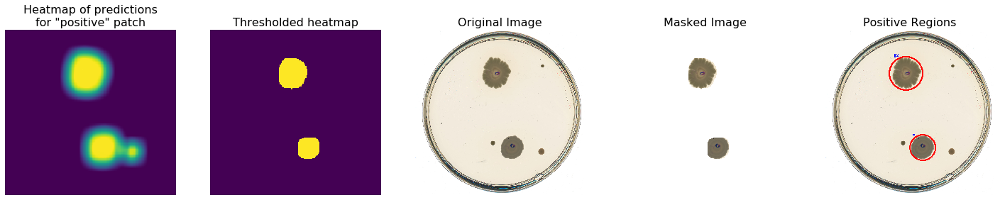



"positive vs negative" heatmap for "Mixed-colony_06_054.jpg" (index 27):


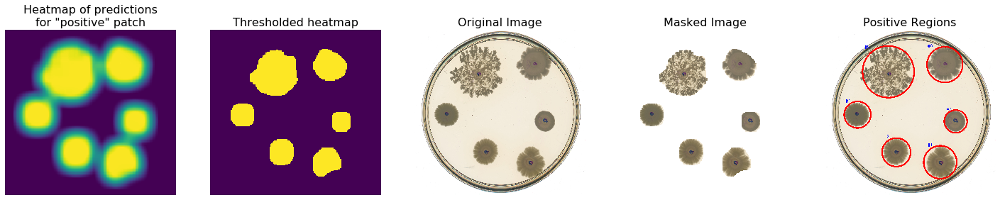



"positive vs negative" heatmap for "Mixed-colony_03_038.jpg" (index 28):


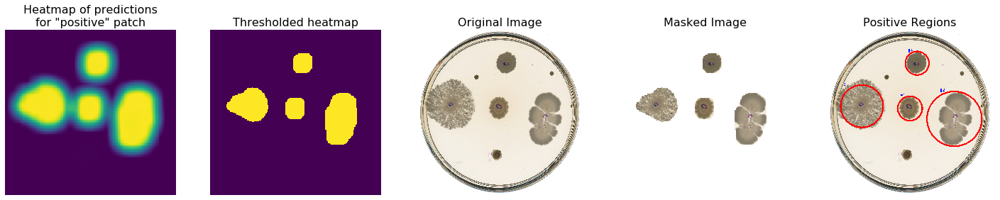



"positive vs negative" heatmap for "Mixed-colony_26_059.jpg" (index 29):


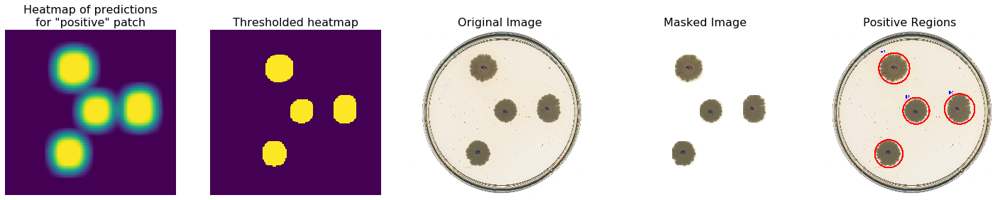

In [247]:
stride = (8,8)
heatmaps_pos = np.copy(heatmaps)
heatmaps_pos[:,:,:,8] = -heatmaps_pos[:,:,:,8] + 255 # prob for 'neg' -> prob for 'pos'

for i, img_path in enumerate(img_paths):
    print('\n\n"positive vs negative" heatmap for "{}" (index {}):'.format(img_path[len(root_path):],i))
    img = cv.imread(img_path)
    img_copy = img.copy()
    heatmap = heatmaps_pos[i][:,:,8].astype('uint8') # channel 8 stores 'pos_vs_neg' probabilities

    plt.figure(figsize=(25,10))
    plt.rcParams["axes.grid"] = False

    plt.subplot(1,5,1),plt.imshow(heatmap)
    plt.axis('off')
    plt.title('Heatmap of predictions\nfor "positive" patch', fontsize=16)

    """we need to scale the heatmap_pos to the original image size:"""
    mask = np.zeros((img.shape[0],img.shape[1]), dtype='uint8') # initial black mask
    for row in range(heatmap.shape[0]):
        for column in range(heatmap.shape[1]):
            mask[row*stride[0]:(row+1)*stride[0],column*stride[1]:(column+1)*stride[1]] = heatmap[row,column]

    ret,thresh = cv.threshold(mask,240,255,cv.THRESH_BINARY) 
    plt.subplot(1,5,2),plt.imshow(thresh)
    plt.axis('off')
    plt.title('Thresholded heatmap', fontsize=16)

    plt.subplot(1,5,3),plt.imshow(img[:, :, [2, 1, 0]]) # From BGR to RGB
    plt.axis('off')
    plt.title('Original Image', fontsize=16)

    thresh = thresh.astype(int)
    img_copy[thresh==0] = 255 # set all pixels outside the threshold, to white color
    plt.subplot(1,5,4),plt.imshow(img_copy[:, :, [2, 1, 0]]) # From BGR to RGB
    plt.axis('off')
    plt.title('Masked Image', fontsize=16)

    thresh = thresh.astype('uint8')
    contours, _ = cv.findContours(thresh.copy(), cv.RETR_EXTERNAL,
                            cv.CHAIN_APPROX_SIMPLE)    
    for (i, c) in enumerate(contours):
        if cv.contourArea(c) >= 1000:
            (x, y, w, h) = cv.boundingRect(c)
            ((cX, cY), radius) = cv.minEnclosingCircle(c)
            if radius <= 262:
                cv.circle(img, (int(cX), int(cY)), int(radius), (0,0,255), 12)
            else:
                cv.rectangle(img,(x,y),(x+w,y+h),(0,0,255),12)
            cv.putText(img, "#{}".format(i + 1), (x, y - 15),
                       cv.FONT_HERSHEY_SIMPLEX, 1, (255, 0, 0), 2)
    plt.subplot(1,5,5),plt.imshow(img[:, :, [2, 1, 0]]) # From BGR to RGB
    plt.axis('off')
    plt.title('Positive Regions', fontsize=16)

    plt.show()

#### <br>**As we can see above, we have well separated colonies on most test images. In those images, the model model can help us identify positive regions corresponding to a single colony and we can then use such info to annotate the top 3 predicted probabilities for each of the indentified single colonies:**

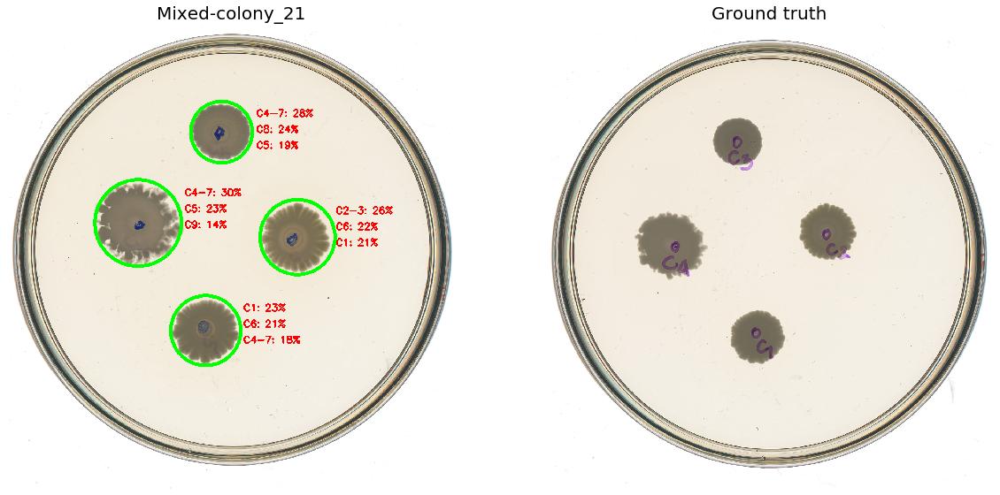

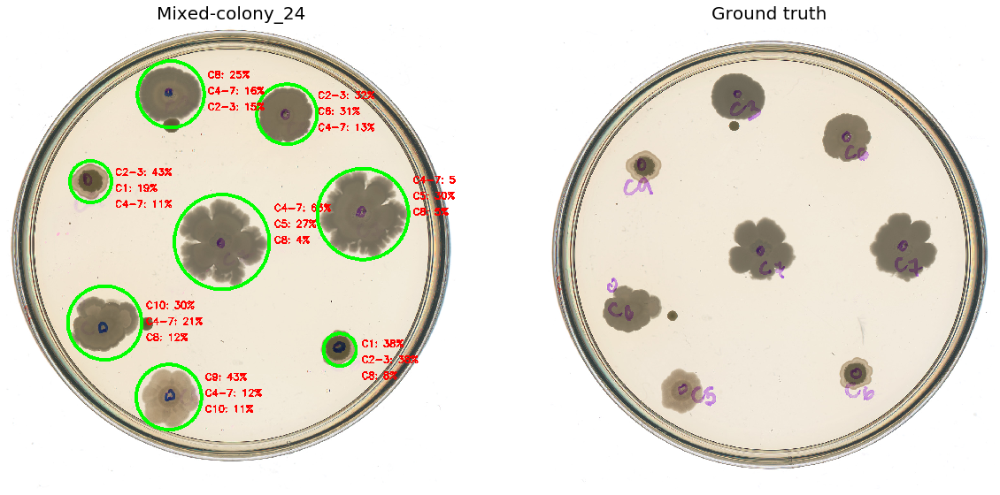

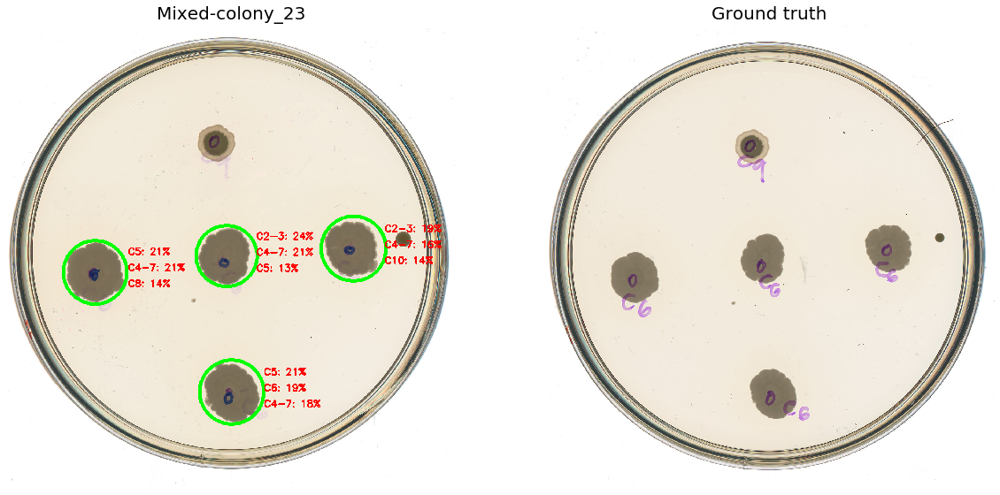

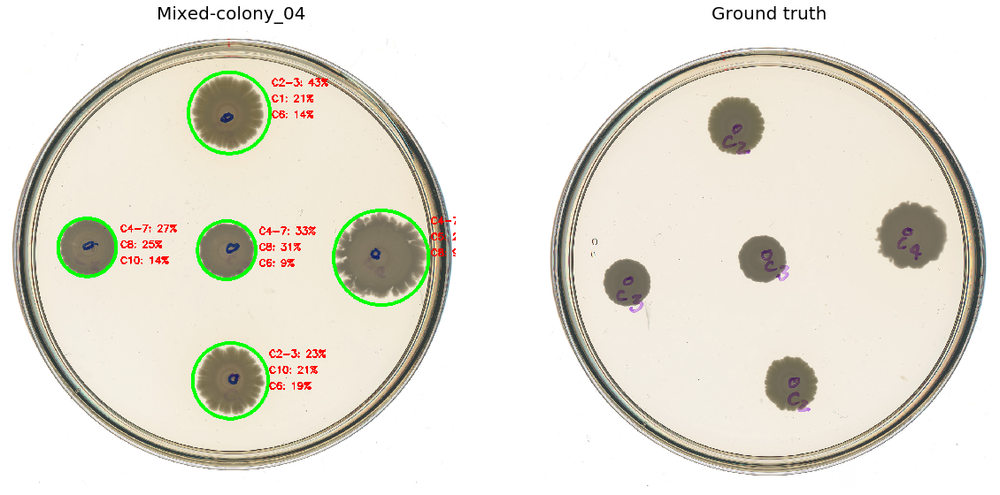

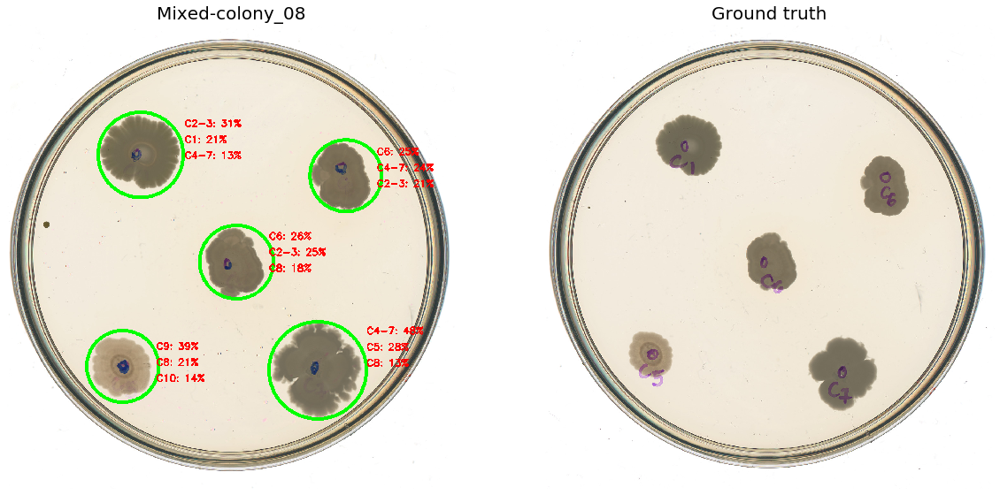

...

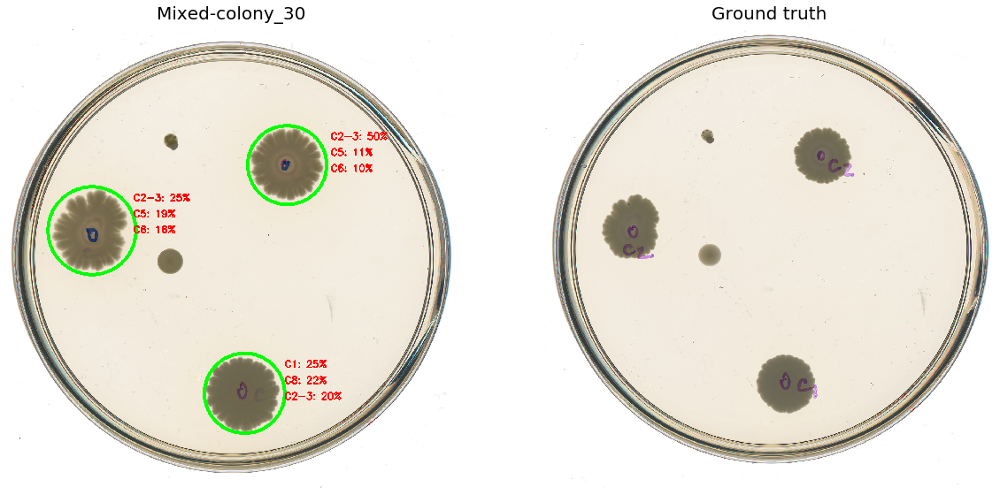

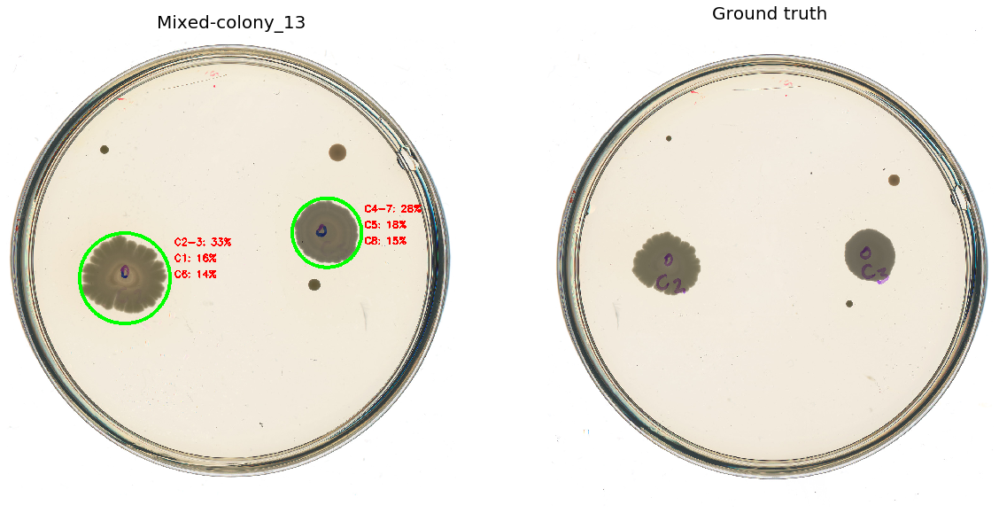

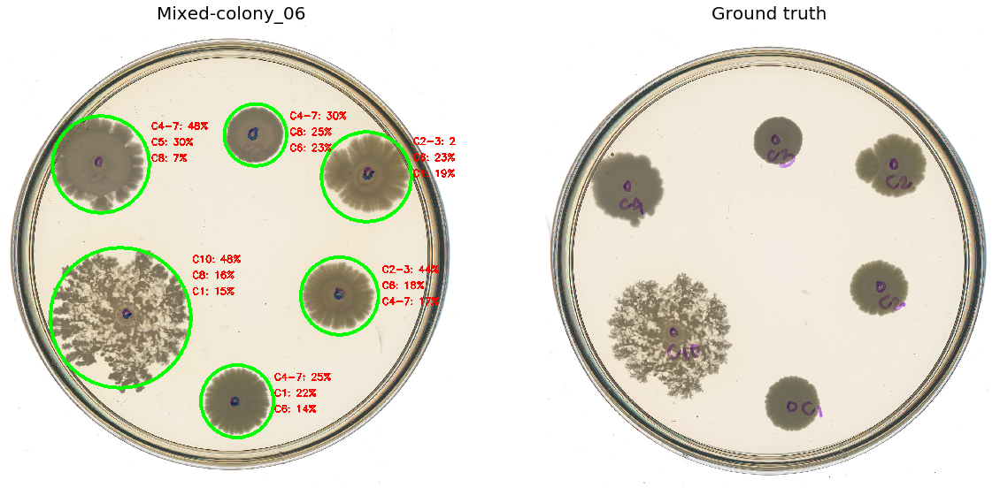

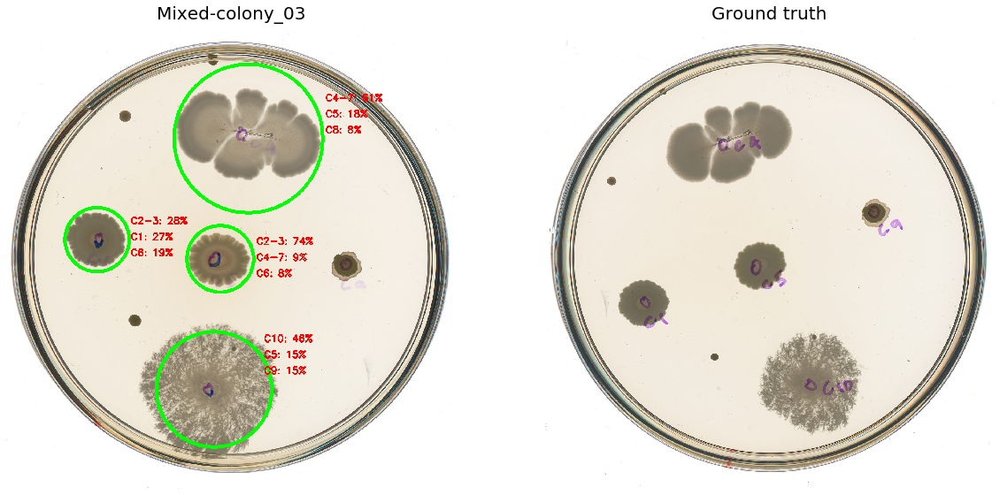

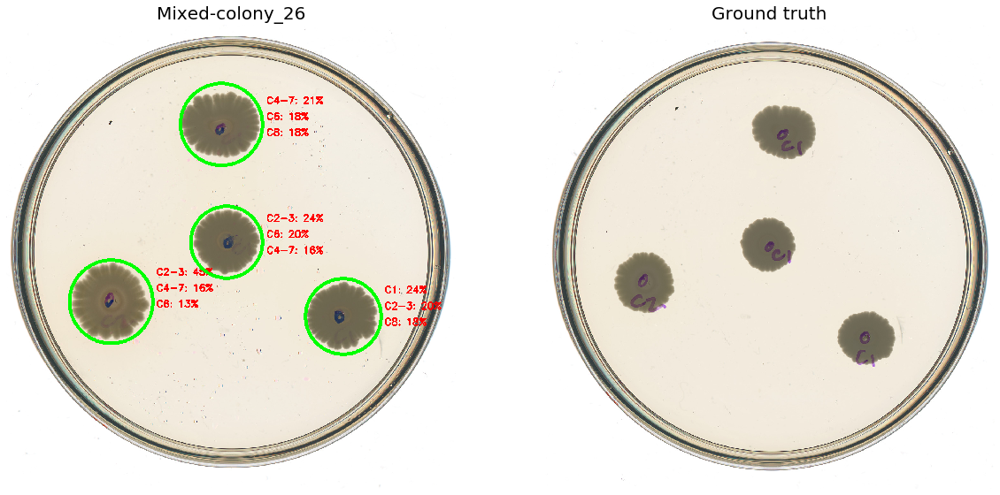

In [236]:
indices = [0,3,8,9,10,11,12,13,16,17,19,22,23,25,26,27,28,29] # well separatd colonies

for i in indices:
    img_path = img_paths[i]
    img = cv.imread(img_path)
    img_name = img_paths[i][len(root_path):len(root_path)+15]
    gt_root_path = 'test_images/mixed_colony_images_gt/'
    for gt_img_name in os.listdir(gt_root_path):
        if img_name in gt_img_name: gt_img_path = gt_root_path + gt_img_name 
    gt_img = cv.imread(gt_img_path) # ground truth image

    img2 = np.rot90(img).copy() # rotate, as we need to rotate gt to read better
    heatmap = np.rot90(heatmaps[i]) # we need to rotate the heatmaps as well
    heatmap_pos = heatmaps_pos[i][:,:,8] # channel 8 stores 'pos_vs_neg' probabilities
    heatmap_pos = np.rot90(heatmap_pos) # we need to rotate the heatmaps as well

    """we need to scale the heatmap to the original image size:"""
    mask = np.zeros((img2.shape[0],img2.shape[1]), dtype='uint8') # initial black mask
    for row in range(heatmap_pos.shape[0]):
        for column in range(heatmap_pos.shape[1]):
            mask[row*stride[0]:(row+1)*stride[0],column*stride[1]:(column+1)*stride[1]] = heatmap_pos[row,column]

    ret,thresh = cv.threshold(mask,240,255,cv.THRESH_BINARY) 
    contours, _ = cv.findContours(thresh.copy(), cv.RETR_EXTERNAL,
                            cv.CHAIN_APPROX_SIMPLE)    
    for (i, c) in enumerate(contours):
        if cv.contourArea(c) >= 1000:
            (x, y, w, h) = cv.boundingRect(c)
            ((cX, cY), radius) = cv.minEnclosingCircle(c)
            if radius <= 262:
                cv.circle(img2, (int(cX), int(cY)), int(radius), (0,255,0), 10)
            else:
                cv.rectangle(img2,(x,y),(x+w,y+h),(0,255,0),10)            
            x1,y1,x2,y2 = int(x/stride[1]),int(y/stride[0]),int((x+w)/stride[1]),int((y+h)/stride[0])
            probs = np.sum(heatmap[y1:y2,x1:x2,:],axis=tuple(range(heatmap.ndim-1)))
            probs *= 100/np.sum(probs) # normalize to 0-100%
            sort_probs = np.argsort(-probs) # "-" to order higher to smaller
            for k in range(3):
                y_pred, prob = sort_probs[k], int(round(probs[sort_probs[k]]))
                cv.putText(img2,'{}: {}%'.format(class_dict[y_pred],prob),
                    (x+w+20,y+30+k*50), cv.FONT_HERSHEY_SIMPLEX, 1.0, (0, 0, 255), 3)

    plt.figure(figsize=(20,10))
    plt.rcParams["axes.grid"] = False
    plt.subplot(1,2,1),plt.imshow(img2[:, :, [2, 1, 0]]) # From BGR to RGB
    plt.axis('off')
    plt.title(img_name, fontsize=20)

    plt.subplot(1,2,2),plt.imshow(np.rot90(gt_img)[:, :, [2, 1, 0]]) # From BGR to RGB
    plt.axis('off')
    plt.title('Ground truth', fontsize=20)

    plt.show()


#### <br>**Another option to visualize the results is to threshold the probability heatmap for each class and annontate regions where the model predicted a high probability for such class.**<br>

#### **As an example, let's visualize the thresholded probability heatmaps on all test images, for the 'C10' class where model performance is better than for other classes:**



visualizing "C10" heatmap for "Mixed-colony_21_"...


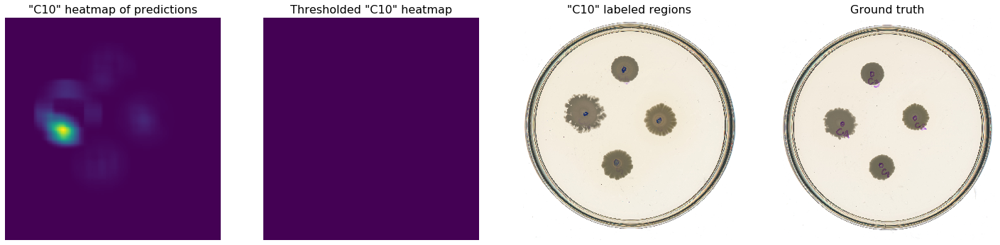



visualizing "C10" heatmap for "Mixed-colony_25_"...


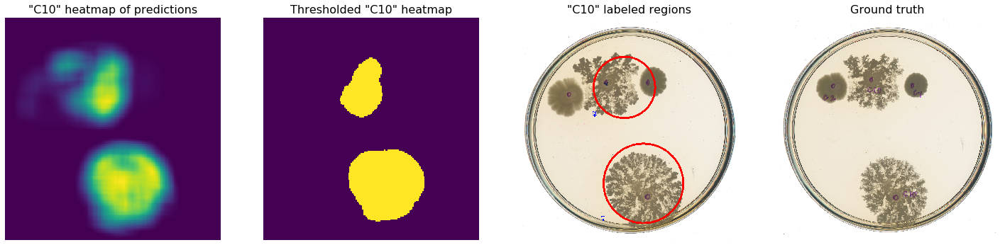



visualizing "C10" heatmap for "Mixed-colony_16_"...


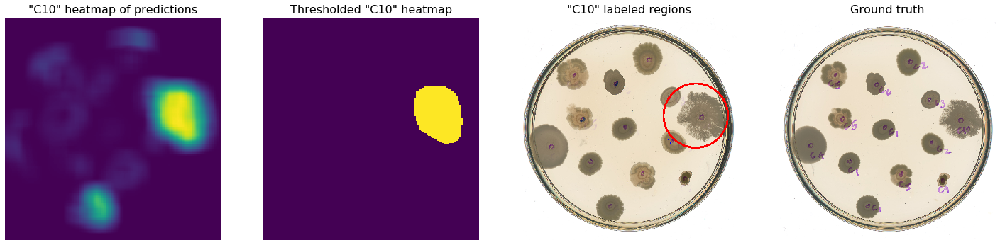



visualizing "C10" heatmap for "Mixed-colony_24_"...


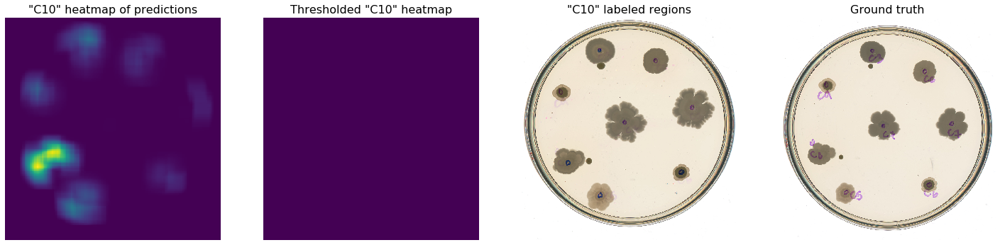



visualizing "C10" heatmap for "Mixed-colony_07_"...


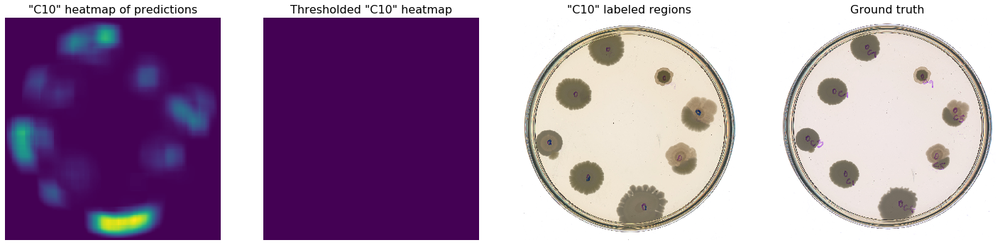



visualizing "C10" heatmap for "Mixed-colony_11_"...


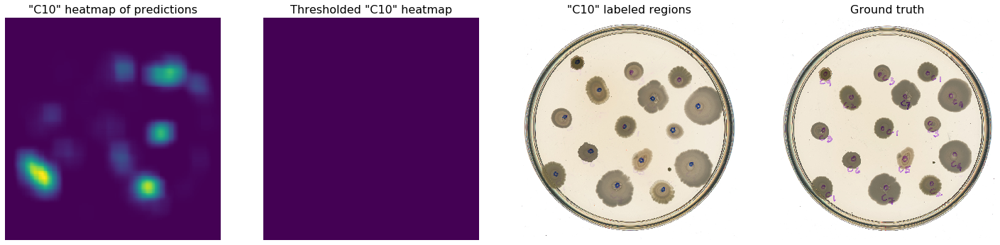



visualizing "C10" heatmap for "Mixed-colony_10_"...


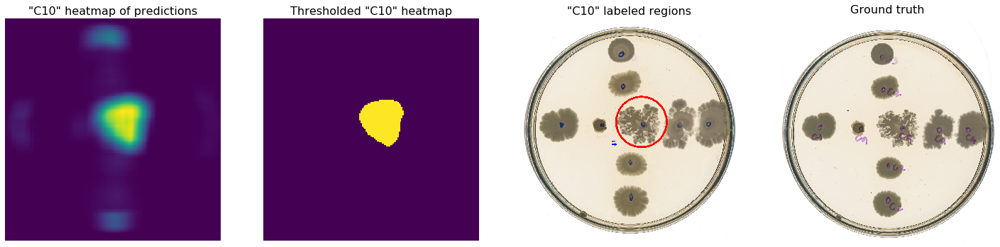



visualizing "C10" heatmap for "Mixed-colony_05_"...


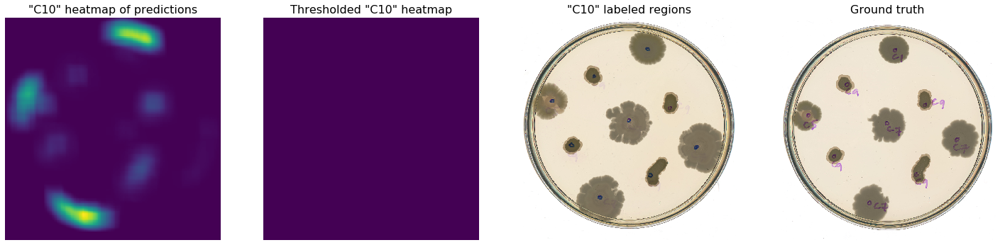



visualizing "C10" heatmap for "Mixed-colony_23_"...


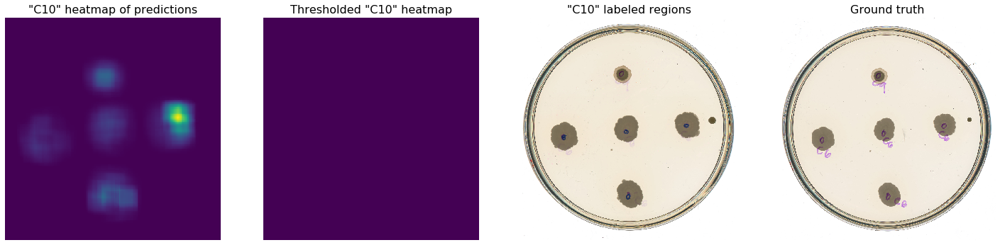



visualizing "C10" heatmap for "Mixed-colony_04_"...


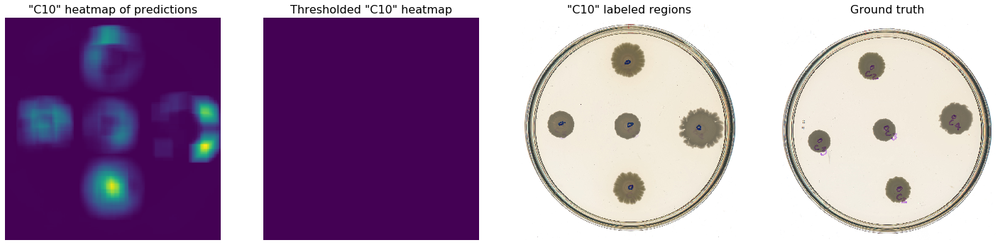



visualizing "C10" heatmap for "Mixed-colony_08_"...


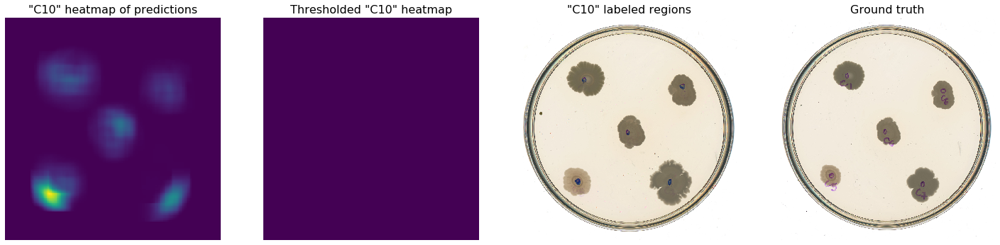



visualizing "C10" heatmap for "Mixed-colony_18_"...


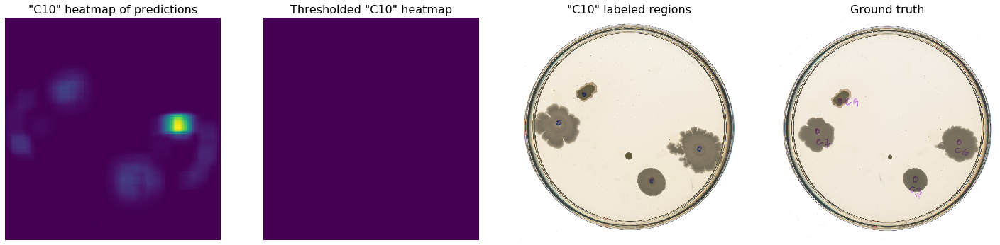



visualizing "C10" heatmap for "Mixed-colony_14_"...


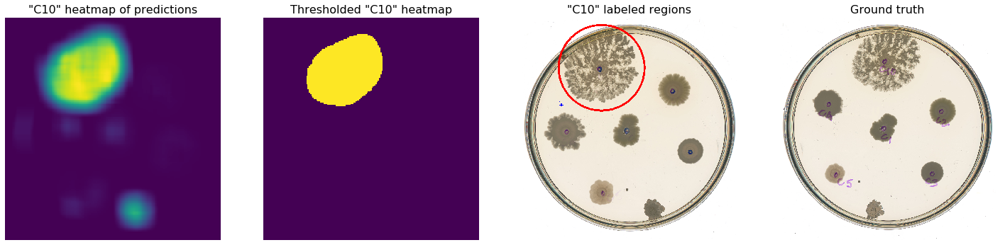



visualizing "C10" heatmap for "Mixed-colony_22_"...


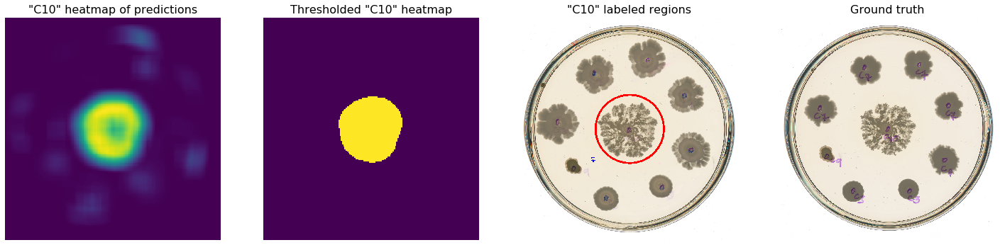



visualizing "C10" heatmap for "Mixed-colony_19_"...


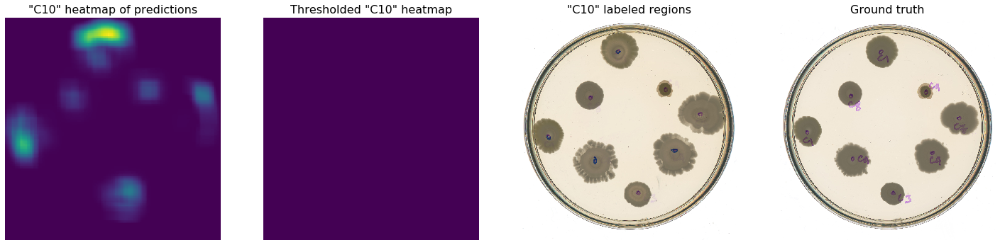



visualizing "C10" heatmap for "Mixed-colony_15_"...


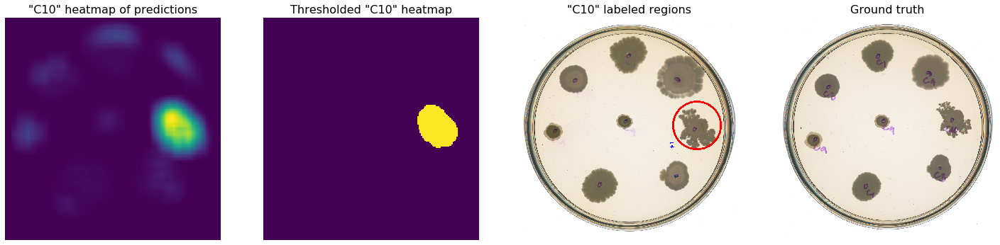



visualizing "C10" heatmap for "Mixed-colony_28_"...


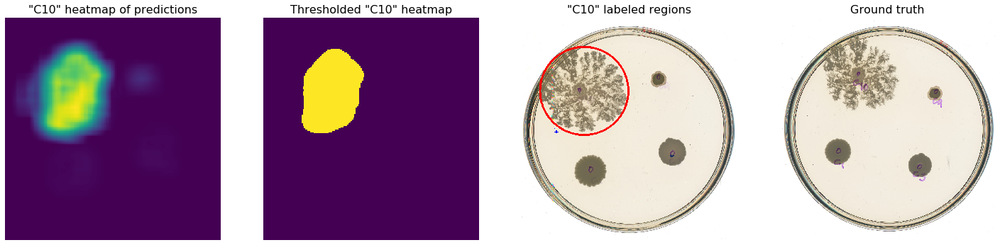



visualizing "C10" heatmap for "Mixed-colony_20_"...


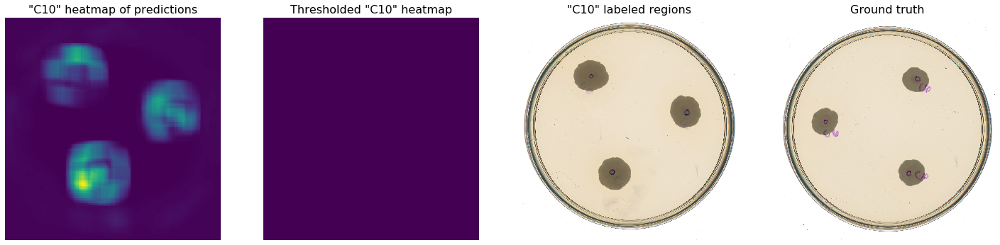



visualizing "C10" heatmap for "Mixed-colony_01_"...


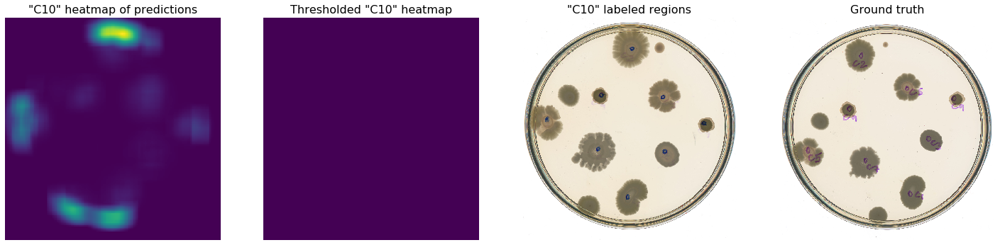



visualizing "C10" heatmap for "Mixed-colony_29_"...


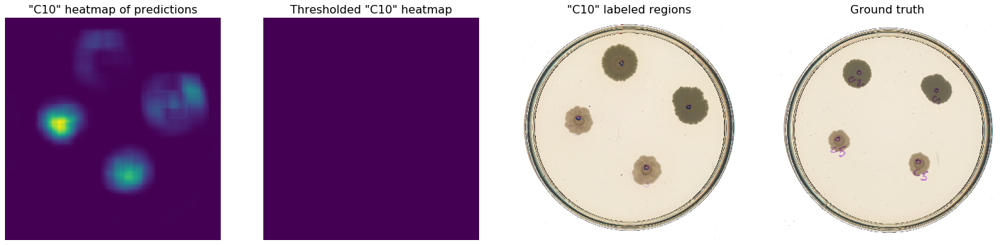



visualizing "C10" heatmap for "Mixed-colony_09_"...


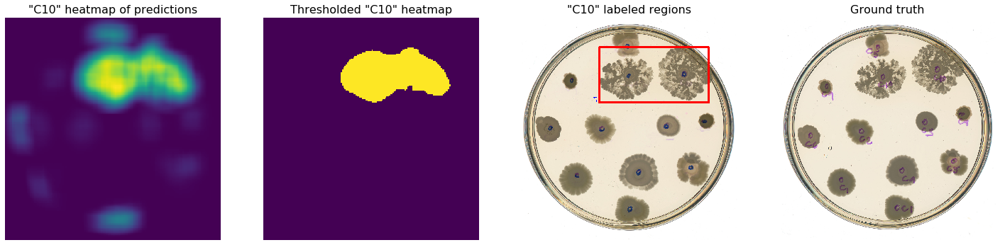



visualizing "C10" heatmap for "Mixed-colony_02_"...


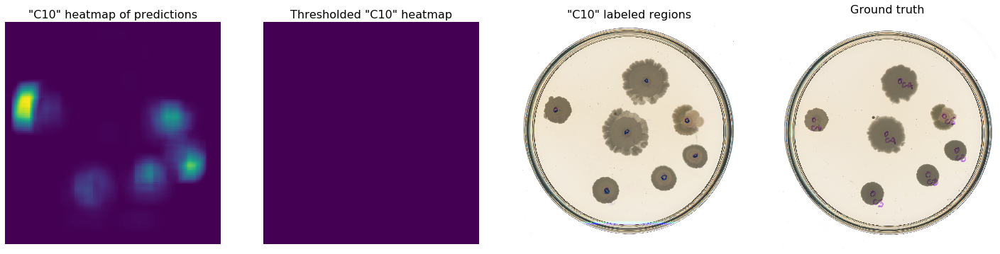



visualizing "C10" heatmap for "Mixed-colony_17_"...


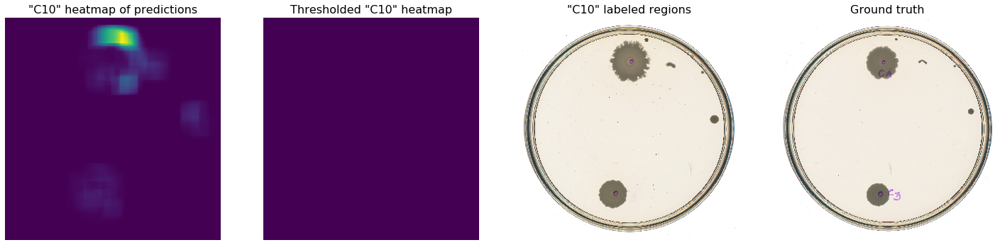



visualizing "C10" heatmap for "Mixed-colony_27_"...


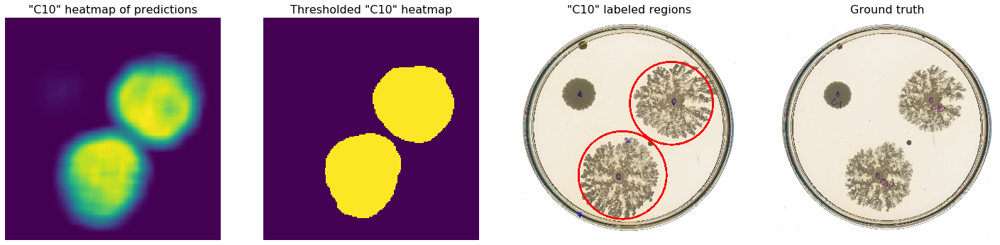



visualizing "C10" heatmap for "Mixed-colony_12_"...


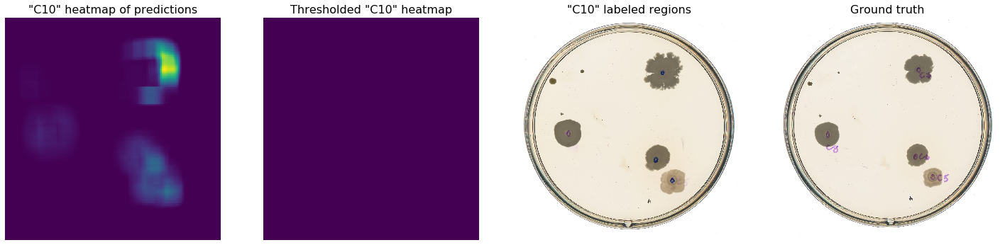



visualizing "C10" heatmap for "Mixed-colony_30_"...


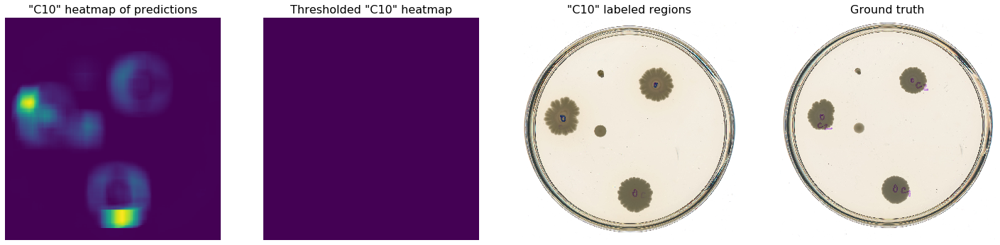



visualizing "C10" heatmap for "Mixed-colony_13_"...


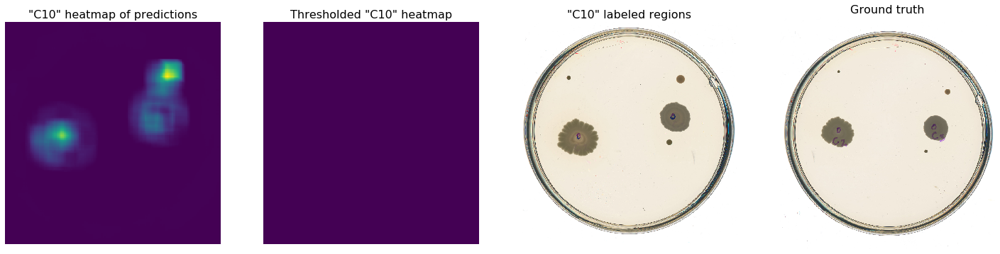



visualizing "C10" heatmap for "Mixed-colony_06_"...


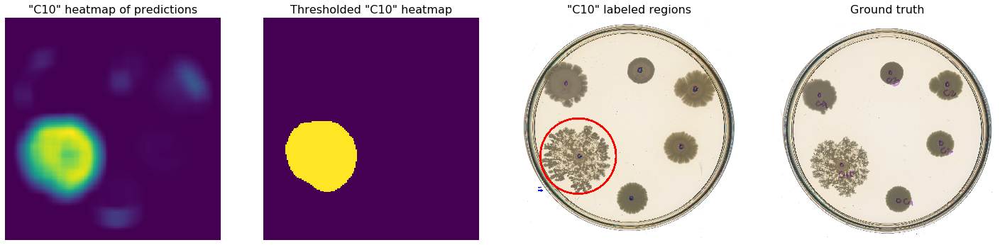



visualizing "C10" heatmap for "Mixed-colony_03_"...


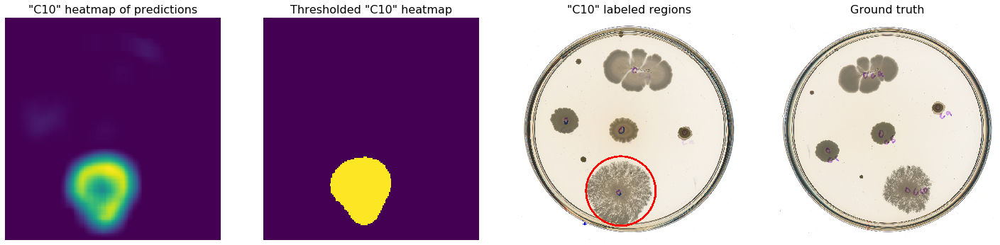



visualizing "C10" heatmap for "Mixed-colony_26_"...


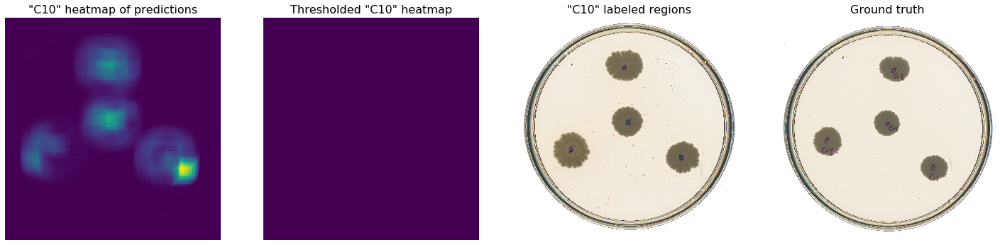

In [248]:
stride = (8,8)
root_path = 'test_images/mixed_colony_images_nogt/'
gt_root_path = 'test_images/mixed_colony_images_gt/'

for i, img_path in enumerate(img_paths):
    img_name = img_path[len(root_path):len(root_path)+16]
    print('\n\nvisualizing "C10" heatmap for "{}"...'.format(img_name))
    img = cv.imread(img_path)
    for gt_img_name in os.listdir(gt_root_path):
        if img_name in gt_img_name: gt_img_path = gt_root_path + gt_img_name 
    gt_img = cv.imread(gt_img_path)
    heatmap = heatmaps[i][:,:,0].astype('uint8') # channel 0 stores 'C10' probabilities

    plt.figure(figsize=(25,10))
    plt.rcParams["axes.grid"] = False

    plt.subplot(1,4,1),plt.imshow(np.rot90(heatmap))
    plt.axis('off')
    plt.title('"C10" heatmap of predictions', fontsize=16)

    """we need to scale the heatmap to the original image size:"""
    mask = np.zeros((img.shape[0],img.shape[1]), dtype='uint8') # initial black mask
    for row in range(heatmap.shape[0]):
        for column in range(heatmap.shape[1]):
            mask[row*stride[0]:(row+1)*stride[0],column*stride[1]:(column+1)*stride[1]] = heatmap[row,column]

    ret,thresh = cv.threshold(mask,130,255,cv.THRESH_BINARY)
    contours, _ = cv.findContours(thresh.copy(), cv.RETR_EXTERNAL,
                            cv.CHAIN_APPROX_SIMPLE)
    new_mask = np.zeros((img.shape[0],img.shape[1]), dtype="uint8") # initiates new 'black' mask
    large_contours = []
    for (i, c) in enumerate(contours):
        if cv.contourArea(c) >= 50000:
            large_contours.append(c)
    cv.drawContours(new_mask, large_contours, -1, (255,255,255), -1) # last -1 -> filled
    plt.subplot(1,4,2),plt.imshow(np.rot90(new_mask))
    plt.axis('off')
    plt.title('Thresholded "C10" heatmap', fontsize=16)
  
    for (i, c) in enumerate(large_contours):
        (x, y, w, h) = cv.boundingRect(c)
        ((cX, cY), radius) = cv.minEnclosingCircle(c)
        if radius <= 350:
            cv.circle(img, (int(cX), int(cY)), int(radius), (0,0,255),12)
        else:
            cv.rectangle(img,(x,y),(x+w,y+h),(0,0,255),12)
        cv.putText(img, "#{}".format(i + 1), (x, y - 15),
                   cv.FONT_HERSHEY_SIMPLEX, 1, (255, 0, 0), 2)
    plt.subplot(1,4,3),plt.imshow(np.rot90(img)[:, :, [2, 1, 0]]) # From BGR to RGB
    plt.axis('off')
    plt.title('"C10" labeled regions', fontsize=16)

    plt.subplot(1,4,4),plt.imshow(np.rot90(gt_img)[:, :, [2, 1, 0]]) # From BGR to RGB
    plt.axis('off')
    plt.title('Ground truth', fontsize=16)

    plt.show()

#### <br>**Lastly, using the class probability heatmaps, we can color-code each region in the image by the highest class probability.**<br> 

#### **For better visualization, we will colour all except the 'negative' class (no colony present):**

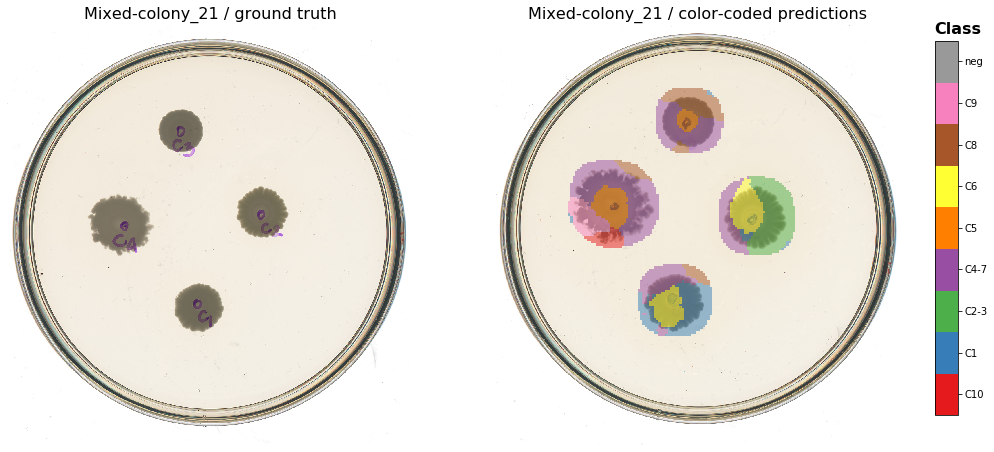

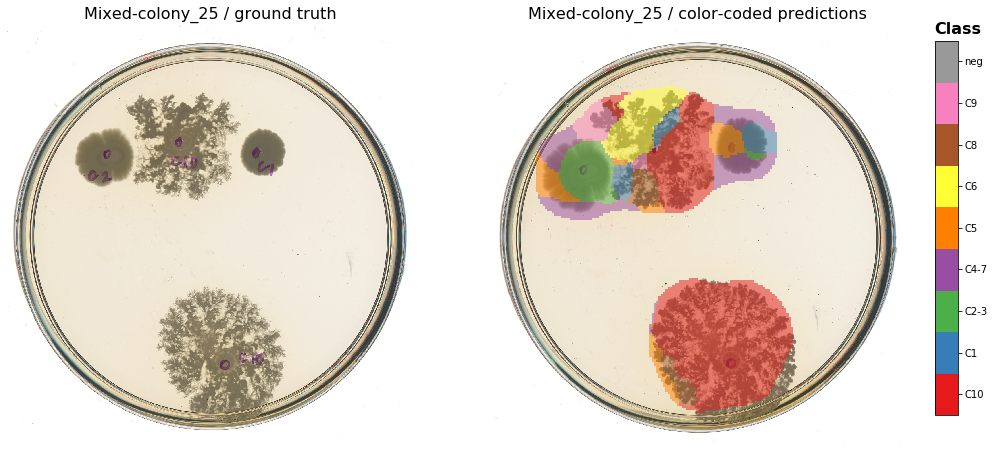

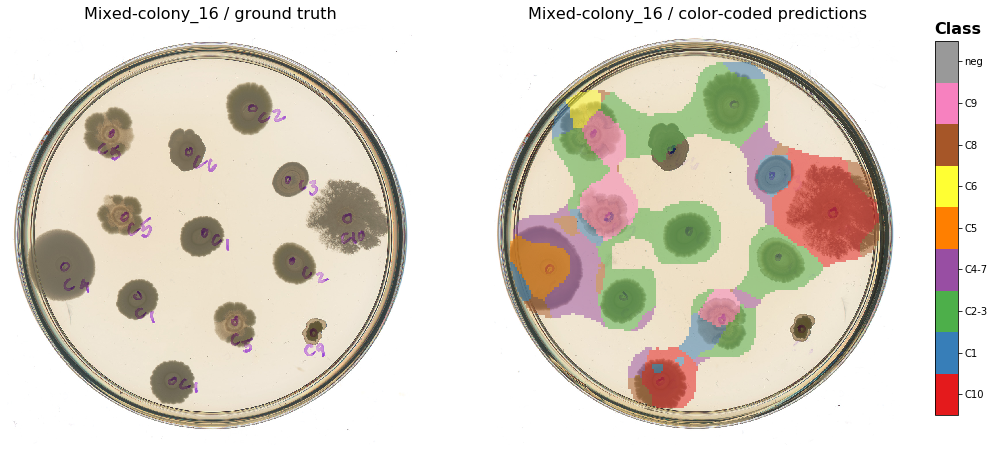

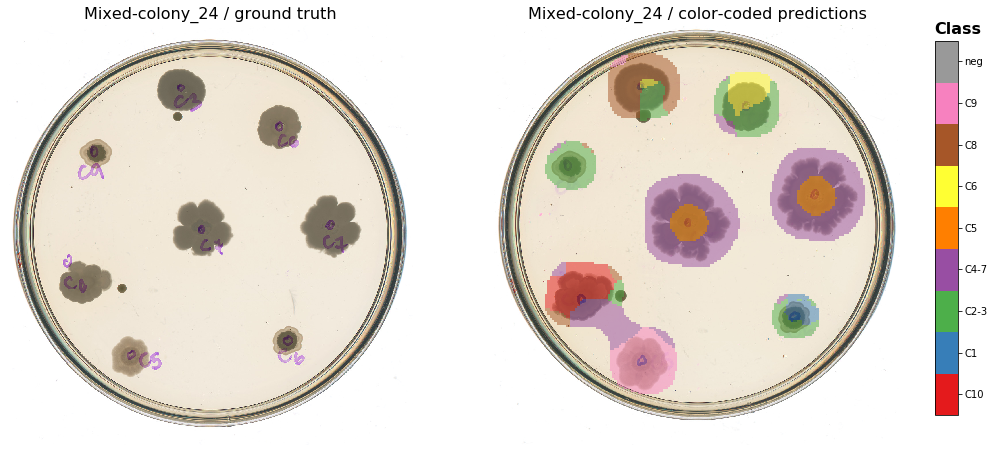

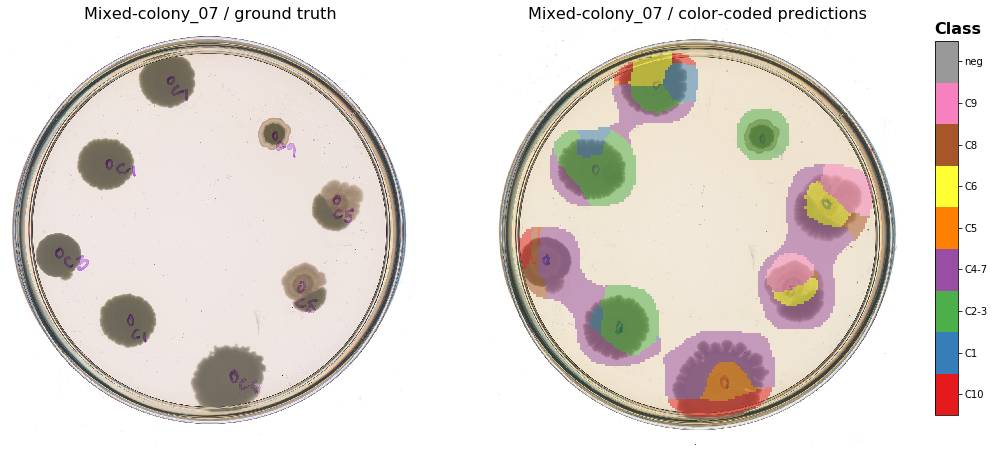

...

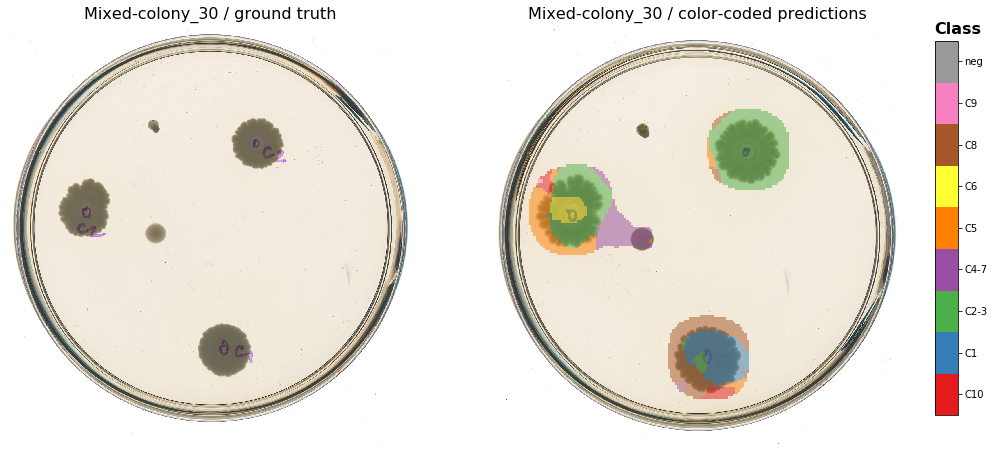

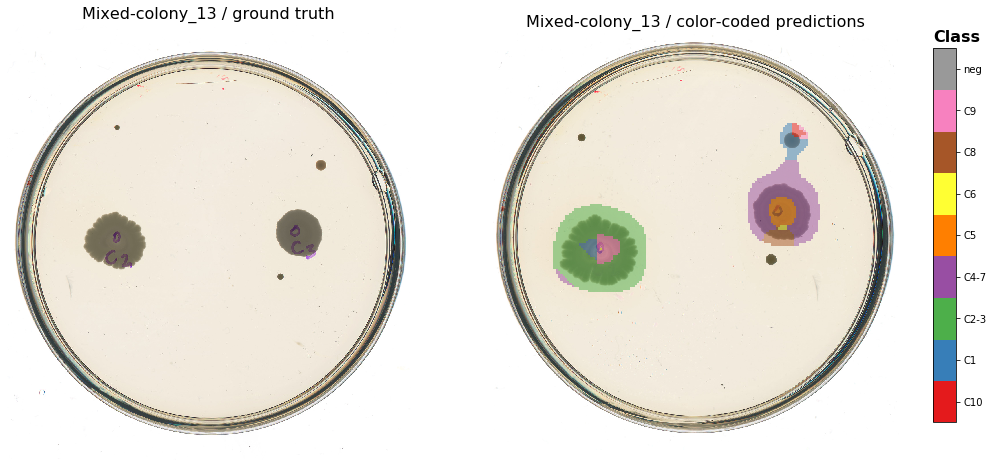

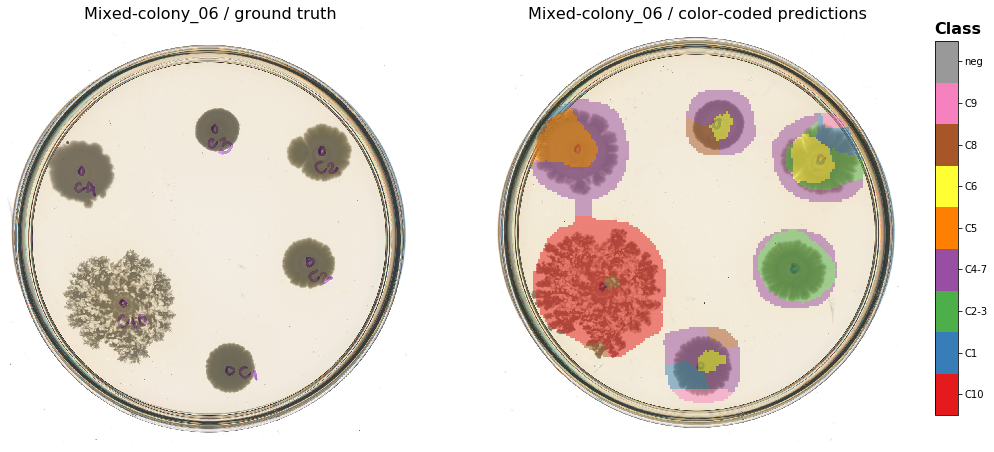

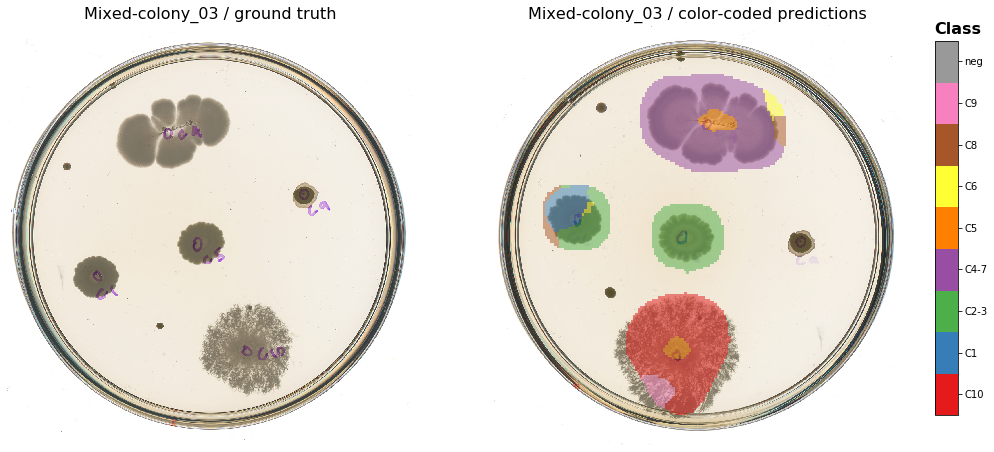

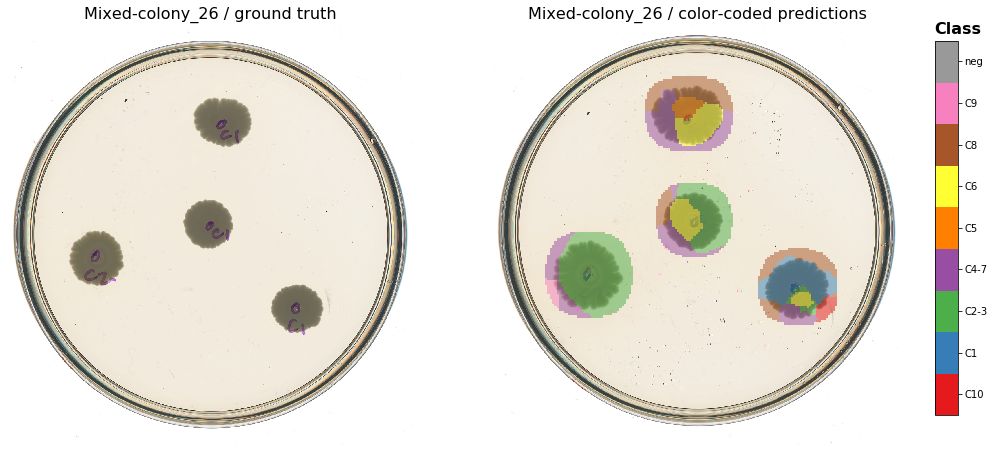

In [451]:
stride = (8,8)
root_path = 'test_images/mixed_colony_images_nogt/'
gt_root_path = 'test_images/mixed_colony_images_gt/'
cmap = plt.cm.get_cmap('Set1',9)

for i, img_path in enumerate(img_paths):
    img_name = img_path[len(root_path):len(root_path)+15]
    img = cv.imread(img_paths[i])
    for gt_img_name in os.listdir(gt_root_path):
        if img_name in gt_img_name: gt_img_path = gt_root_path + gt_img_name 
    gt_img = cv.imread(gt_img_path)
    heatmap = heatmaps[i]
    overlay = img.copy()
    mask = np.ones(img.shape, dtype='uint8') # initial white mask
    for row in range(heatmap.shape[0]):
        for column in range(heatmap.shape[1]):
            max_ = np.argmax(heatmap[row,column])
            if max_ != 8 and heatmap[row,column,8] < 80:
                cv.rectangle(overlay, (column*stride[1],row*stride[0]),((column+1)*stride[1],
                            (row+1)*stride[0]), (cmap(max_)[2]*255,cmap(max_)[1]*255,cmap(max_)[0]*255),-1)
    output = img.copy()
    opacity = 0.5
    cv.addWeighted(overlay, opacity, output, 1-opacity, 0, output)

    fig = plt.figure(figsize=(16,8))
    plt.rcParams["axes.grid"] = False

    plt.subplot(1,2,1),plt.imshow(np.rot90(gt_img)[:, :, [2, 1, 0]]) # From BGR to RGB
    plt.axis('off')
    plt.title('{} / ground truth'.format(img_name), fontsize=16)

    plt.subplot(1,2,2),plt.imshow(np.rot90(output)[:, :, [2, 1, 0]], cmap=cmap) # From BGR to RGB
    plt.axis('off')
    plt.title('{} / color-coded predictions'.format(img_name), fontsize=16)

    cax = fig.add_axes([.93,.19,.02,.65])
    formatter = plt.FuncFormatter(lambda val, loc: class_dict[val])
    cbar = plt.colorbar(cax=cax,ticks=range(0,9),format=formatter)
    cbar.set_label('Class',labelpad=-30,y=1.05,fontsize=16,weight='bold',rotation=0)
    plt.clim(-0.5, 8.5)

    plt.show()